In [199]:
import sympy as sp
import numpy as np
from matplotlib import pyplot as plt
from matplotlib import animation,rc
from mpl_toolkits.mplot3d import Axes3D


def ejes3d(x0,y0,z0,x1,y1,z1,ejes='x'):
    #fig=plt.figure(figsize=(8,6),dpi=80)
    #ax = plt.Axes(fig,[0.,0.,1.,1.])
    fig = plt.figure()
    ax = Axes3D(fig)
    #fig=plt.figure()
    #ax=fig.add_subplot(111,projection='3d')
    ax.set_xlim([x0,x1])
    ax.set_ylim([y0,y1])
    ax.set_zlim([z0,z1])
    ax.set_xlabel('$'+ejes+'_0$')
    ax.set_ylabel('$'+ejes+'_1$')
    ax.set_zlabel('$'+ejes+'_2$')
    punto3d(ax,(0,0,0),nombre=r'$\vec{0}$')

    return fig,ax

#def animacion_paso_3d(ax):
#    return lambda i: ax.view_init(elev=10., azim=i)

def dibujo():                           # En esta rutina se colocan los puntos y líneas para la animación
    return fig,    

def animacion_paso_3d(ax,fig,angulo):
    ax.view_init(elev=10., azim=angulo)
    return fig, 

def animacion3d(fig,ax,dibujo=dibujo, fps=10, segundos=1):
    rc('animation', html='jshtml')
    frames=fps*segundos
    return animation.FuncAnimation(fig, lambda i : animacion_paso_3d(ax,fig,i/frames*90), init_func=dibujo,
                               frames=frames, interval=int(1000/fps), blit=True)

def linea3d(ax,u,v=(0,0,0),color='k',**kwargs):
    ax.plot((u[0],v[0]),(u[1],v[1]),(u[2],v[2]),color)

def plano3d(ax,u,v,color='k',**kwargs):
    x_min,x_max=ax.get_xlim()
    y_min,y_max=ax.get_ylim()
    det=u[0]*v[1]-u[1]*v[0]
    kx=(v[1]*u[2]-u[1]*v[2])/det
    ky=-(v[0]*u[2]-u[0]*v[2])/det

    xx=[[x_min,x_max],[x_min,x_max]]
    yy=[[y_min,y_min],[y_max,y_max]]
    zz=np.array([[kx*x_min+ky*y_min,kx*x_max+ky*y_min],[kx*x_min+ky*y_max,kx*x_max+ky*y_max]]).astype(np.float64)

    ax.plot_surface(xx, yy, zz, alpha=0.2)
    #ax.scatter(u[0], u[1], u[2], color='green')
    #ax.scatter(v[0], v[1], v[2], color='green')

    
def punto3d(ax,v,nombre='',fontsize=15, c="goldenrod",**kwargs):
    ax.scatter(v[0],v[1],float(v[2]), marker='o', s=20, c="goldenrod", alpha=0.6)
    if nombre!='':
        ax.text(v[0],v[1],v[2],nombre,fontsize=fontsize)        

def p(v):
    return '('+', '.join([str(ai) for ai in v])+')\u209c'

Con el fin de aumentar la velocidad de ejecución para las pruebas puede disminuir los `fps` y los `segundos` en la rutina  `animacion3d`.

# Subespacios de $\mathbb{R}^3$





La dimensión de $Nu(A)$ (el espacio nulo de $A$) es $\nu(A)$ (la nulidad de $A$). Recordemos que <u>una base de $Nu(A)$ consiste en el conjunto de soluciones particulares básicas del sistema homogéneo $[A:0]$</u>.

La dimensión de $Co(C)$ (el espacio columna de $C$) es $\rho(C)$ (el rango de $C$). Recordemos que <u>una base de $Co(C)$ se obtiene al quitar las columnas que no tienen l-pivote</u>.

En ambos casos, $Nu(A)$ y $Co(C)$, <u>la dimensión es el número de elementos de la base. 

| Dimensión | Representación geométrica | 
|  -        |        -        |
|   0       | Es el origen       |
|1 |         Es una recta que pasa por el origen y por ...|
|2 |  Es un plano que pasa por el origen, por ... y por ... | 
|3 |  Es todo $\mathbb{R}^3$ | 



# Coordenadas
Recordemos que las columnas de una matriz $B$ de tamaño $m \times n$, forman una **base de un subespacio $S$** si y solo si
* $\text{Co}(B)=S$ y
* $S$ es LI


Si el vector $\vec{t} \in \mathbb{R}^n$ cumple que

$B\vec{t}=\vec{x}$ 

entonces $\vec{t}$ se llama las **coordenadas de  $\vec{x}$ en la base $B$** y se denota

$\vec{t}=[\vec{x}]_B$

Informalmente hablando, es como si se despejara $\vec{t}$, de la ecuación $B\vec{t}=\vec{x}$

## Importancia de la base
Es de resaltar que esta definición tiene sentido porque:
* Como una base genera todo el espacio S, entonces para todos los elementos de $S$ hay coordenadas.
* Como los vectores de la base son LI. Entonces por cada elemento de $S$ sólo hay una coordenada $\vec{t}$. 

## Ejemplo

Sea la base $B=\left[\matrix{ 1 & 2 \\ 3 & 4 \\ 5 & 6}\right]$ 

Como $\left[\matrix{ 1 & 2 \\ 3 & 4 \\ 5 & 6}\right]\left(\matrix{ 4 \\ -3 }\right)=\left(\matrix{ -2 \\ 0 \\ 2 }\right)$

Entonces las coordenadas de $\left(\matrix{ -2 \\ 0 \\ 2 }\right)$ en la base $B$ es  $\left(\matrix{ 4 \\ -3 }\right)$

$\left[\left(\matrix{ -2 \\ 0 \\ 2 }\right)\right]_B=\left(\matrix{ 4 \\ -3 }\right)$




## Base estándar  de $\mathbb{R}^m$ 
Las columnas de la matriz identidad $I_m$ forman la base estándar  de $\mathbb{R}^m$. En estas bases las coordenadas son iguales al vector. $\vec{x}=I_m\vec{t}=\vec{t}$.

# Visualización de un vector  en $\mathbb{R}^3$
A continuación se usarán las anteriores rutinas sobre Matplotlib para dibujar el vector $\vec{u}=\left(\matrix{ 8 \\ 9 \\3}\right)$ de $\mathbb{R}^3$ 

In [201]:
u0=sp.Matrix([8,
              9,
              3])

print('v='+p(u0))

v=(8, 9, 3)ₜ


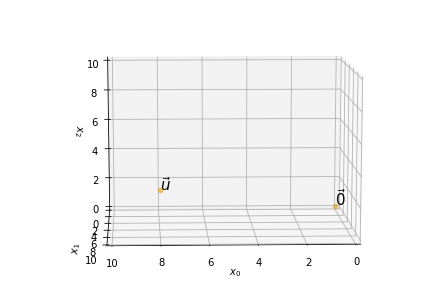

In [202]:
fig,ax=ejes3d(0,0,0,10,10,10) # Define el eje de coordenadas
                              # Desde la coordenada (0,0,0)ₜ
                              # Hasta la coordenada (10,10,10)ₜ

punto3d(ax,u0,nombre=r'$\vec{u}$')  # Coloca el punto

animacion3d(fig,ax)  # Genera la animación para rotar  


# Visualización de suma de vectores en $\mathbb{R}^3$


In [136]:
u1=sp.Matrix([2,
              3,
              4])

v1=sp.Matrix([5,
              1,
              4])

print('w='+p(u1)+'+'+p(v1)+'='+p(u1+v1))

w=(2, 3, 4)ₜ+(5, 1, 4)ₜ=(7, 4, 8)ₜ


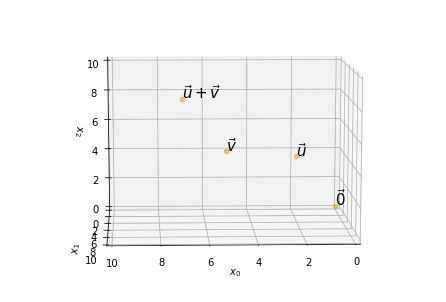

In [137]:
fig,ax=ejes3d(0,0,0,10,10,10) # Define el eje de coordenadas
                              # Desde la coordenada (0,0,0)ₜ
                              # Hasta la coordenada (10,10,10)ₜ

punto3d(ax,u1,nombre=r'$\vec{u}$')  # Coloca el punto
punto3d(ax,v1,nombre=r'$\vec{v}$')  # Coloca el punto
punto3d(ax,u1+v1,nombre=r'$\vec{u}+\vec{v}$')  # Coloca el punto

animacion3d(fig,ax)  # Genera la animación para rotar  

El origen de coordenadas, los dos sumandos y el resultado; forman los vértices de un paralelogramo. Por esto, la suma de vectores se conoce como la ley del paralelogramo.

# Visualización de escalar por vector en $\mathbb{R}^3$

Al multiplicar un vector por una constante, cada componente se multiplica por la misma constante y por lo tanto el vector se desplaza en línea recta respecto al origen. 

In [138]:
u2=sp.Matrix([4,
              2,
              3])

print('v=2'+p(u2)+'='+p(2*u2))

v=2(4, 2, 3)ₜ=(8, 4, 6)ₜ


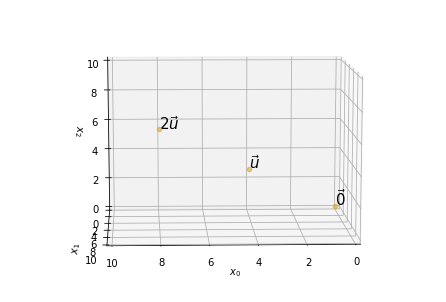

In [139]:
fig,ax=ejes3d(0,0,0,10,10,10) # Define el eje de coordenadas
                              # Desde la coordenada (0,0,0)ₜ
                              # Hasta la coordenada (10,10,10)ₜ

punto3d(ax,u2,nombre=r'$\vec{u}$')  # Coloca el punto
punto3d(ax,2*u2,nombre=r'$2\vec{u}$')  # Coloca el punto
#punto3d(ax,u1+v1,nombre=r'$\vec{u}+\vec{v}$')  # Coloca el punto

animacion3d(fig,ax)  # Genera la animación para rotar  

In [140]:
print('1/2'+p(u2)+'='+p(u2/2))
print('3/2'+p(u2)+'='+p(u2*3/2))

1/2(4, 2, 3)ₜ=(2, 1, 3/2)ₜ
3/2(4, 2, 3)ₜ=(6, 3, 9/2)ₜ


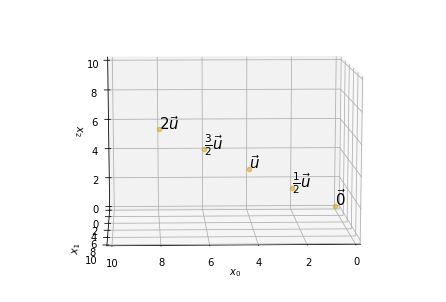

In [141]:
fig,ax=ejes3d(0,0,0,10,10,10) # Define el eje de coordenadas
                              # Desde la coordenada (0,0,0)ₜ
                              # Hasta la coordenada (10,10,10)ₜ

punto3d(ax,u2,nombre=r'$\vec{u}$')  # Coloca el punto
punto3d(ax,2*u2,nombre=r'$2\vec{u}$')  # Coloca el punto
punto3d(ax,u2/2,nombre=r'$\frac{1}{2}\vec{u}$')  # Coloca el punto
punto3d(ax,u2*3/2,nombre=r'$\frac{3}{2}\vec{u}$')  # Coloca el punto

animacion3d(fig,ax)  # Genera la animación para rotar  

Se podría interpretar que el vector $u$ es una unidad de medida, el cual genera una nueva escala.


# Subespacio generado en $\mathbb{R}^3$ cuando hay 3 l-pivotes

(1) Encontrar una base del espacio generado por los vectores  $\vec{u}_0=\left(\matrix{ 9 \\ 3 \\ 6}\right)$,   $\vec{u}_1=\left(\matrix{ 2 \\ 8 \\ 5 }\right)$, $\vec{u}_2=\left(\matrix{ 11 \\ 11 \\ 11 }\right)$   y $\vec{u}_3=\left(\matrix{ 1 \\ 2 \\ 7 }\right)$. O lo que es lo mismo, el espacio columna de la matriz $A=\left[\matrix{ 9 & 2 & 11 & 1\\ 3 & 8 & 11 & 2 \\ 6 & 5 & 11 & 7 }\right]$.

A continuación, se grafican los vectores.

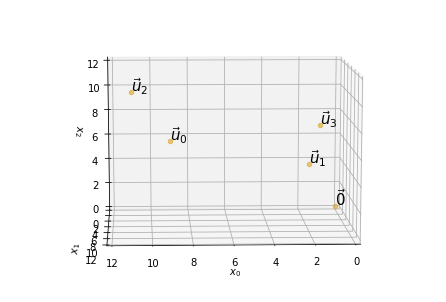

In [142]:
u3_0=sp.Matrix([9,
                3,
                6])

u3_1=sp.Matrix([2,
                8,
                5])

u3_2=sp.Matrix([11,
                11,
                11])

u3_3=sp.Matrix([1,
                2,
                7])

fig,ax=ejes3d(0,0,0,12,12,12)  # Define el eje de coordenadas
                              # Desde la coordenada (0,0,0)ₜ
                              # Hasta la coordenada (10,10,10)ₜ

punto3d(ax,u3_0,nombre=r'$\vec{u}_0$')  # Coloca el punto
punto3d(ax,u3_1,nombre=r'$\vec{u}_1$')  # Coloca el punto
punto3d(ax,u3_2,nombre=r'$\vec{u}_2$')  # Coloca el punto
punto3d(ax,u3_3,nombre=r'$\vec{u}_3$')  # Coloca el punto

animacion3d(fig,ax)  # Genera la animación para rotar  

El siguiente paso es encontrar los l-pivotes de la matriz.

In [143]:
M=sp.Matrix([[ 9, 2, 11, 1], [ 3, 8, 11, 2], [6, 5, 11,  7]])
M

Matrix([
[9, 2, 11, 1],
[3, 8, 11, 2],
[6, 5, 11, 7]])

In [144]:
M.row_swap(0,1)
M

Matrix([
[3, 8, 11, 2],
[9, 2, 11, 1],
[6, 5, 11, 7]])

In [145]:
M[1,:] += -3*M[0,:]
M[2,:] += -2*M[0,:]
M

Matrix([
[3,   8,  11,  2],
[0, -22, -22, -5],
[0, -11, -11,  3]])

In [146]:
M.row_swap(1,2)
M

Matrix([
[3,   8,  11,  2],
[0, -11, -11,  3],
[0, -22, -22, -5]])

In [147]:
M[2,:] += -2*M[1,:]
M

Matrix([
[3,   8,  11,   2],
[0, -11, -11,   3],
[0,   0,   0, -11]])

Los l-pivotes de la matriz $A$ son los elementos subrayados.

$\left[\matrix{ \underline{9} & 2 & 11 & 1\\ 3 & \underline{8} & 11 & 2 \\ 6 & 5 & 11 & \underline{7} }\right]$.

Como no todas las columnas tienen l-pivote, es posible quitar la tercera columna. 

En conclusión. Una base para $\text{Co}\left(\left[\matrix{ 9 & 2 & 11 & 1\\ 3 & 8 & 11 & 2 \\ 6 & 5 & 11 & 7 }\right]\right)$ es la matriz $B=\left[\matrix{ 9 & 2 & 1\\ 3 & 8 & 2 \\ 6 & 5 & 7 }\right]$.

(2) La dimensión del espacio es el número de columnas de la base. En este caso la dimensión del espacio es 3.

(3) Geométricamente hablando, el espacio generado es todo $\mathbb{R}^3$. Esto se puede concluir de dos formas. 
* Primero, porque la dimensión es 3.
* Segundo, porque hay un l-pivote en cada renglón.

(4) Visualizar que genera todo el espacio no es fácil, en todo caso lo traté de representar con este cubo que llena todo el  sistema coordenado.

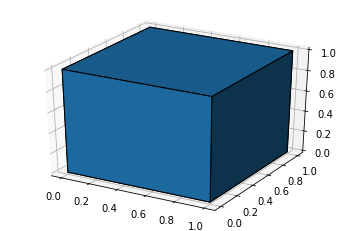

In [148]:
# Omitir este código
# Este código pretende ilustrar que el espacio generado es todo R**3
#from mpl_toolkits.mplot3d import Axes3D
import numpy as np
import matplotlib.pyplot as plt

fig = plt.figure()
ax = fig.gca(projection='3d')
ax.voxels(np.ones((1,1,1)), edgecolor="k")
plt.show()


(5) Cual es el punto $\vec{x}$ con coordenada $\vec{t}=\left(\matrix{4\\2\\3}\right)$ en la base $B$. 
 
Solución:
Sabemos que las coordenadas $\vec{t}$ del vector $\vec{x}$ en la base $B$ cumplen la siguiente relación:

$B\vec{t}=\vec{x}$ 

Como se conoce la base $B=\left[\matrix{ 9 & 2 & 1 \\ 3 & 8 & 2 \\ 6 & 5 & 7 }\right]$ y las coordenadas $\vec{t}=\left(\matrix{4\\2\\3}\right)$ entonces sólo hay que calcular el resultado.

$\left[\matrix{ 9 & 2 & 1 \\ 3 & 8 & 2 \\ 6 & 5 & 7 }\right]\left(\matrix{4\\2\\3}\right)= $

In [149]:
sp.Matrix([[ 9, 2, 1], 
           [ 3, 8, 2], 
           [ 6, 5, 7]])*sp.Matrix([4,
                                   2,
                                   3])

Matrix([
[43],
[34],
[55]])

(6) Encuentre la coordenada $\vec{t}$ en la base $B$ del punto $\vec{x}=\left(\matrix{2\\1\\\frac{3}{2}}\right)$


Solución:
En este caso se conoce la base $B=\left[\matrix{ 9 & 2 & 1 \\ 3 & 8 & 2 \\ 6 & 5 & 7 }\right]$ y el punto $\vec{x}=\left(\matrix{2\\1\\\frac{3}{2}}\right)$ y tenemos que encontrar las coordenada $\vec{t}$ que cumpla

$\left[\matrix{ 9 & 2 & 1 \\ 3 & 8 & 2 \\ 6 & 5 & 7 }\right]\vec{t}= \left(\matrix{2\\1\\ \frac{3}{2}}\right)$

Para esto hay que solucionar la siguiente matriz extendida usando Gauss - Jordan.


In [150]:
M=sp.Matrix([[ 9, 2, 1, 2], 
           [ 3, 8, 2, 1], 
           [ 6, 5, 7, sp.Rational(3,2)]])
M

Matrix([
[9, 2, 1,   2],
[3, 8, 2,   1],
[6, 5, 7, 3/2]])

In [151]:
M.row_swap(0,1)
M

Matrix([
[3, 8, 2,   1],
[9, 2, 1,   2],
[6, 5, 7, 3/2]])

In [152]:
M[1,:] += -3*M[0,:]
M[2,:] += -2*M[0,:]
M

Matrix([
[3,   8,  2,    1],
[0, -22, -5,   -1],
[0, -11,  3, -1/2]])

In [153]:
M.row_swap(1,2)
M

Matrix([
[3,   8,  2,    1],
[0, -11,  3, -1/2],
[0, -22, -5,   -1]])

In [154]:
M[2,:] += -2*M[1,:]
M[0,:] += M[1,:]*8/11
M

Matrix([
[3,   0, 46/11, 7/11],
[0, -11,     3, -1/2],
[0,   0,   -11,    0]])

In [155]:
M[0,:] += M[2,:]*46/121
M[1,:] += M[2,:]*3/11
M

Matrix([
[3,   0,   0, 7/11],
[0, -11,   0, -1/2],
[0,   0, -11,    0]])

In [156]:
M[0,:] *= sp.Rational(1,3)
M[1,:] *= -sp.Rational(1,11)
M[2,:] *= -sp.Rational(1,11)
M

Matrix([
[1, 0, 0, 7/33],
[0, 1, 0, 1/22],
[0, 0, 1,    0]])

Entonces las coordenadas son $\vec{x}=\left(\matrix{\frac{7}{33} \\ \frac{1}{22} \\ 0}\right)$

# Subespacio generado en $\mathbb{R}^3$ cuando hay 2 l-pivotes

(1) Encontrar una base del espacio generado por los vectores  $\vec{u}_0=\left(\matrix{ 9 \\ 3 \\ 6}\right)$,   $\vec{u}_1=\left(\matrix{ 2 \\ 8 \\ 5 }\right)$   y $\vec{u}_2
=\left(\matrix{ 11 \\ 11 \\ 11 }\right)$. O lo que es lo mismo, el espacio columna de la matriz $A=\left[\matrix{ 9 & 2 & 11\\ 3 & 8 & 11 \\ 6 & 5 & 11 }\right]$.

A continuación, se grafican los vectores.

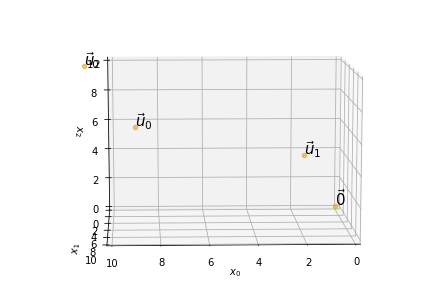

In [157]:
u3_0=sp.Matrix([9,
                3,
                6])

u3_1=sp.Matrix([2,
                8,
                5])

u3_2=sp.Matrix([11,
                11,
                11])

fig,ax=ejes3d(0,0,0,10,10,10)  # Define el eje de coordenadas
                              # Desde la coordenada (0,0,0)ₜ
                              # Hasta la coordenada (10,10,10)ₜ

punto3d(ax,u3_0,nombre=r'$\vec{u}_0$')  # Coloca el punto
punto3d(ax,u3_1,nombre=r'$\vec{u}_1$')  # Coloca el punto
punto3d(ax,u3_2,nombre=r'$\vec{u}_2$')  # Coloca el punto

animacion3d(fig,ax)  # Genera la animación para rotar  

El siguiente paso es encontrar los l-pivotes de la matriz.

In [158]:
M=sp.Matrix([[ 9, 2, 11], [ 3, 8, 11], [6, 5,  11]])
M

Matrix([
[9, 2, 11],
[3, 8, 11],
[6, 5, 11]])

In [159]:
M.row_swap(0,1)
M

Matrix([
[3, 8, 11],
[9, 2, 11],
[6, 5, 11]])

In [160]:
M[1,:] += -3*M[0,:]
M[2,:] += -2*M[0,:]
M

Matrix([
[3,   8,  11],
[0, -22, -22],
[0, -11, -11]])

In [161]:
M.row_swap(1,2)
M

Matrix([
[3,   8,  11],
[0, -11, -11],
[0, -22, -22]])

In [162]:
M[2,:] += -2*M[1,:]
M

Matrix([
[3,   8,  11],
[0, -11, -11],
[0,   0,   0]])

Los l-pivotes de la matriz $A$ son los elementos subrayados.

$\left[\matrix{ \underline{9} & 2 & 11\\ 3 & \underline{8} & 11 \\ 6 & 5 & 11 }\right]$.

Como la última columna de los vectores no tiene l-pivote, entonces es posible quitarla. 

En conclusión. Una base para $\text{Co}\left(\left[\matrix{ 9 & 2 & 11\\ 3 & 8 & 11 \\ 6 & 5 & 11 }\right]\right)$ es la matriz $B=\left[\matrix{ 9 & 2 \\ 3 & 8 \\ 6 & 5 }\right]$.

(2) La dimensión del espacio es el número de columnas de la base. En este caso la dimensión del espacio es 2.

(3) Geométricamente hablando, el espacio generado es un plano que pasa por el origen, por el vector $\left(\matrix{9\\3\\6}\right)$ y por el vector $\left(\matrix{2\\8\\5}\right)$.

(4) A continuación se visualiza el plano generado. Observe que aunque el plano fue generado sólo con dos vectores, los tres vectores se encuentran en el plano.

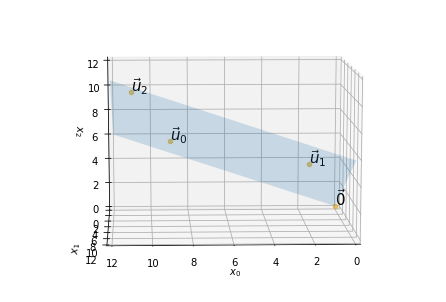

In [208]:
fig,ax=ejes3d(0,0,0,12,12,12)  # Define el eje de coordenadas
                              # Desde la coordenada (0,0,0)ₜ
                              # Hasta la coordenada (10,10,10)ₜ
M=sp.Matrix([[ 9, 2, 11], [ 3, 8, 11], [6, 5,  11]])
u=M[:,0]
v=M[:,1]
w=M[:,2]

punto3d(ax,u,nombre=r'$\vec{u}_0$')  # Coloca el punto
punto3d(ax,v,nombre=r'$\vec{u}_1$')  # Coloca el punto
punto3d(ax,w,nombre=r'$\vec{u}_2$')  # Coloca el punto
plano3d(ax,u,v,color='k')

animacion3d(fig,ax)  # Genera la animación para rotar  


(5) Cual es el punto $\vec{x}$ con coordenada $\vec{t}=\left(\matrix{3\\2}\right)$ en la base $B$. 
 
 
 

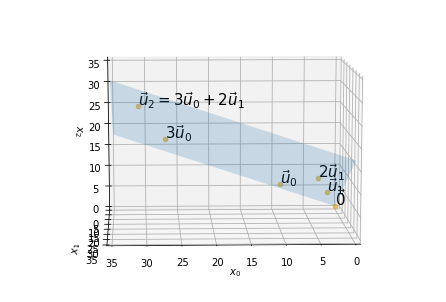

In [209]:
fig,ax=ejes3d(0,0,0,35,35,35)  # Define el eje de coordenadas

u=sp.Matrix([9,
             3,
             6]) # Primer vector de la base
v=sp.Matrix([2,
             8,
             5]) # Segundo vector de la base
w=sp.Matrix([31,
             25,
             28]) #Vector con coordenadas (3,2)ₜ  

punto3d(ax,u,nombre=r'$\vec{u}_0$')  # Coloca el punto
punto3d(ax,v,nombre=r'$\vec{u}_1$')  # Coloca el punto
punto3d(ax,3*u,nombre=r'$3\vec{u}_0$')  # Coloca el punto
punto3d(ax,2*v,nombre=r'$2\vec{u}_1$')  # Coloca el punto
punto3d(ax,w,nombre=r'$\vec{u}_2=3\vec{u}_0+2\vec{u}_1$')  # Coloca el punto
plano3d(ax,u,v,color='k')

animacion3d(fig,ax)  # Genera la animación para rotar  


Solución:
Sabemos que las coordenadas $\vec{t}$ del vector $\vec{x}$ en la base $B$ cumplen la siguiente relación:

$B\vec{t}=\vec{x}$ 

Como se conoce la base $B=\left[\matrix{ 9 & 2 \\ 3 & 8  \\ 6 & 5 }\right]$ y las coordenadas $\vec{t}=\left(\matrix{3\\2}\right)$ entonces sólo hay que calcular el resultado.

$\left[\matrix{ 9 & 2  \\ 3 & 8  \\ 6 & 5  }\right]\left(\matrix{3\\2}\right)= $

In [210]:
sp.Matrix([[ 9, 2], 
           [ 3, 8], 
           [ 6, 5]])*sp.Matrix([3,
                                2])

Matrix([
[31],
[25],
[28]])

Observe que el vector $\vec{u}_2$ se puede alcanzar usando como guía el vector $\vec{u}_0$ y $\vec{u}_1$. De esta forma sólo requiere dos coordenadas $\left(\matrix{3\\2}\right)$, a pesar de que está en $\mathbb{R}^3$

(6) Encuentre las coordenadas $\vec{t}$ en la base $B=\left[\matrix{ 9 & 2 \\ 3 & 8  \\ 6 & 5 }\right]$ del punto $\vec{x}=\left(\matrix{13\\19\\16}\right)$

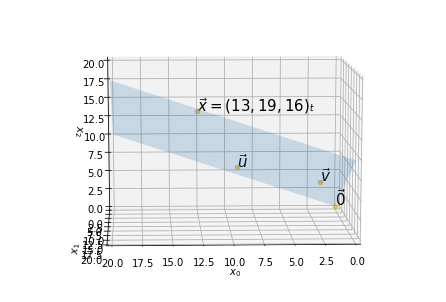

In [207]:
fig,ax=ejes3d(0,0,0,20,20,20)  # Define el eje de coordenadas

u=sp.Matrix([9,
             3,
             6]) # Primer vector de la base
v=sp.Matrix([2,
             8,
             5]) # Segundo vector de la base
w=sp.Matrix([13,
             19,
             16]) #Vector con coordenadas (3,2)ₜ  

punto3d(ax,u,nombre=r'$\vec{u}$')  # Coloca el punto
punto3d(ax,v,nombre=r'$\vec{v}$')  # Coloca el punto
punto3d(ax,w,nombre=r'$\vec{x}=(13,19,16)ₜ$')  # Coloca el punto
plano3d(ax,u,v,color='k')

animacion3d(fig,ax)  # Genera la animación para rotar  


Solución:
Hay que encontrar las coordenada $\vec{t}$ que cumpla

$\left[\matrix{ 9 & 2  \\ 3 & 8  \\ 6 & 5 }\right]\vec{t}= \left(\matrix{13\\19\\16}\right)$

Para esto hay que solucionar la siguiente matriz extendida usando Gauss - Jordan.

In [166]:
M=sp.Matrix([[ 9, 2, 13], 
           [ 3, 8, 19], 
           [ 6, 5, 16]])
M

Matrix([
[9, 2, 13],
[3, 8, 19],
[6, 5, 16]])

In [167]:
M.row_swap(0,1)
M

Matrix([
[3, 8, 19],
[9, 2, 13],
[6, 5, 16]])

In [168]:
M[1,:] += -3*M[0,:]
M[2,:] += -2*M[0,:]
M

Matrix([
[3,   8,  19],
[0, -22, -44],
[0, -11, -22]])

In [169]:
M.row_swap(1,2)
M

Matrix([
[3,   8,  19],
[0, -11, -22],
[0, -22, -44]])

In [170]:
M[2,:] += -2*M[1,:]
M[0,:] += M[1,:]*8/11
M

Matrix([
[3,   0,   3],
[0, -11, -22],
[0,   0,   0]])

In [171]:
M[0,:] *= sp.Rational(1,3)
M[1,:] *= -sp.Rational(1,11)
M

Matrix([
[1, 0, 1],
[0, 1, 2],
[0, 0, 0]])

$\begin{align}
1t_0 + 0t_1 = 1 \\
0t_0 + 1t_1 = 2 \\
0t_0 + 0t_1 = 0 
\end{align}$

Entonces las coordenadas son 

$\vec{t}=\left(\matrix{1 \\ 2 }\right)$

# Subespacio generado en $\mathbb{R}^3$ cuando hay 1 l-pivote

(1) Encontrar una base del espacio generado por los vectores $\vec{u}_0=\left(\matrix{ 4 \\ 2 \\ 8 }\right)$, $\vec{u}_1=\left(\matrix{ 2 \\ 1 \\ 4 }\right)$  y $\vec{u}_2=\left(\matrix{ 6 \\ 3 \\ 12 }\right)$. O lo que es lo mismo, el espacio columna de la matriz  $A=\left[\matrix{ 4 & 2 & 6 \\ 2 & 1 & 3 \\
8 & 4 & 12 }\right]$.

A continuación, se grafican los vectores.

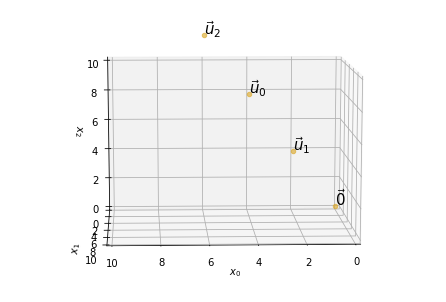

In [172]:
u4_0=sp.Matrix([4,
                2,
                8])
u4_1=sp.Matrix([2,
                1,
                4])
u4_2=sp.Matrix([6,
                3,
                12])


fig,ax=ejes3d(0,0,0,10,10,10)  # Define el eje de coordenadas
                              # Desde la coordenada (0,0,0)ₜ
                              # Hasta la coordenada (10,10,10)ₜ

punto3d(ax,u4_0,nombre=r'$\vec{u}_0$')  # Coloca el punto
punto3d(ax,u4_1,nombre=r'$\vec{u}_1$')  # Coloca el punto
punto3d(ax,u4_2,nombre=r'$\vec{u}_2$')  # Coloca el punto

animacion3d(fig,ax)  # Genera la animación para rotar  

Sean $\vec{u}_0=\left(\matrix{ 4 \\ 2 \\ 8 }\right)$, $\vec{u}_1=\left(\matrix{ 2 \\ 1 \\ 4 }\right)$  y $\vec{u}_2=\left(\matrix{ 6 \\ 3 \\ 12 }\right)$


El siguiente paso es encontrar los l-pivotes de la matriz.




$
\left[\matrix{ 4 & 2 & 6\\ 2 & 1 & 3  \\ 8 & 4 & 12 }\right]
 \sim
\left[\matrix{ 2 & 1 & 3\\ 4 & 2 & 6 \\ 8 & 4 & 12 }\right]
 \sim
\left[\matrix{ \underline{2} & 1 & 3 \\ 0 & 0 & 0 & \\ 0 & 0 & 0}\right]
$


Debido a que hay columnas que no tienen l-pivote podemos utilizar el Teorema de reducción del conjunto generador [ Nakos, 2.9, pg 92].  En este caso nos permite eliminar el segundo y el tercer vector.

$\text{Gen}\left\{ \left(\matrix{ 4 \\ 2 \\ 8 }\right),  \left(\matrix{  2 \\ 1 \\ 4}\right),  \left(\matrix{ 6 \\ 3 \\ 12}\right)  \right\}=
\text{Gen}\left\{ \left(\matrix{ 4 \\ 2 \\ 8 }\right) \right\}$


La base para $\text{Co}\left(
\left[\matrix{ 4 & 2 & 6\\ 2 & 1 & 3  \\ 8 & 4 & 12 }\right]\right)$ es la matriz de una columna $B=\left[\matrix{ 4 \\ 2  \\ 8 }\right]$.

(2) Como la base sólo tiene una columna, la dimenesión del espacio columna 
La base para $\text{Co}\left(
\left[\matrix{ 4 & 2 & 6\\ 2 & 1 & 3  \\ 8 & 4 & 12 }\right]\right)$ es 1

(3) Geométricamente, el espacio columna es una recta que pasa por $\left(\matrix{ 0 \\ 0 \\0}\right)$ y $\left(\matrix{ 4 \\ 2 \\ 8 }\right)$.

(4) A continuación se visualiza la recta generada. Observe que aunque la recta fue generado sólo con un vector, los tres vectores se encuentran en la recta.



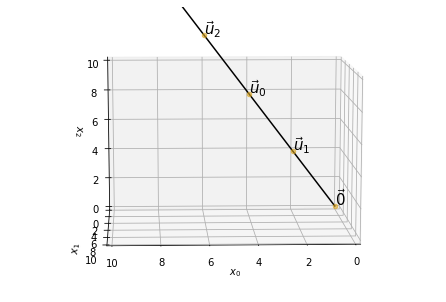

In [173]:
fig,ax=ejes3d(0,0,0,10,10,10)  # Define el eje de coordenadas
                              # Desde la coordenada (0,0,0)ₜ
                              # Hasta la coordenada (10,10,10)ₜ

punto3d(ax,u4_0,nombre=r'$\vec{u}_0$')  # Coloca el punto
punto3d(ax,u4_1,nombre=r'$\vec{u}_1$')  # Coloca el punto
punto3d(ax,u4_2,nombre=r'$\vec{u}_2$')  # Coloca el punto
linea3d(ax,2.1*u4_0)  # Coloca  las línea entre dos extremos, si solo hay un extremo el otro es el origen


animacion3d(fig,ax)  # Genera la animación para rotar  

(5) ¿Cuál es el punto $\vec{x}$ con coordenada $\vec{t}=(2)$ en la base $\left[\matrix{4\\2\\8}\right]$?

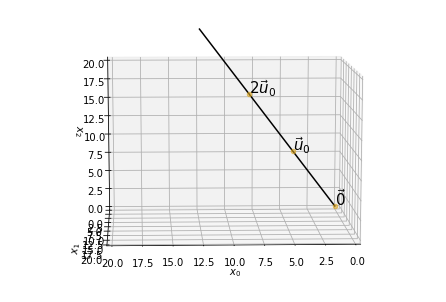

In [211]:
u4_0=sp.Matrix([4,
                2,
                8])


fig,ax=ejes3d(0,0,0,20,20,20)  # Define el eje de coordenadas
                              # Desde la coordenada (0,0,0)ₜ
                              # Hasta la coordenada (10,10,10)ₜ

punto3d(ax,u4_0,nombre=r'$\vec{u}_0$')  # Coloca el punto
punto3d(ax,2*u4_0,nombre=r'$2\vec{u}_0$')  # Coloca el punto
linea3d(ax,3.1*u4_0)  # Coloca  las línea entre dos extremos, si solo hay un extremo el otro es el origen


animacion3d(fig,ax)  # Genera la animación para rotar  

Solución:
Sabemos que las coordenadas $\vec{t}$ del vector $\vec{x}$ en la base $B$ cumplen la siguiente relación:

$B\vec{t}=\vec{x}$ 

Como se conoce la base $B=\left[\matrix{4\\2\\8}\right]$ y la coordenada $\vec{t}=(2)$ entonces sólo hay que calcular el resultado.

$\left[\matrix{4\\2\\8}\right](2)= \left(\matrix{8\\4\\16}\right)$

(6) Encuentre la coordenada $\vec{t}$ en la base $\left[\matrix{4\\2\\8}\right]$ del punto $\vec{x}=\left(\matrix{2\\1\\4}\right)$

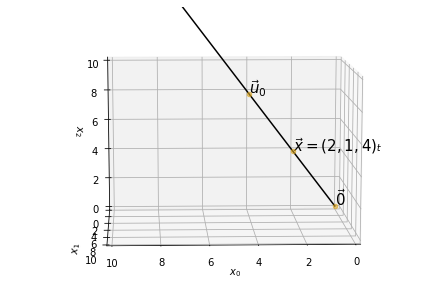

In [216]:
u4_0=sp.Matrix([4,
                2,
                8])


fig,ax=ejes3d(0,0,0,10,10,10)  # Define el eje de coordenadas
                              # Desde la coordenada (0,0,0)ₜ
                              # Hasta la coordenada (10,10,10)ₜ

punto3d(ax,u4_0,nombre=r'$\vec{u}_0$')  # Coloca el punto
punto3d(ax,(2,1,4),nombre=r'$\vec{x}=(2,1,4)ₜ$')  # Coloca el punto
linea3d(ax,3.1*u4_0)  # Coloca  las línea entre dos extremos, si solo hay un extremo el otro es el origen


animacion3d(fig,ax)  # Genera la animación para rotar  

Solución:

 En este caso se conoce la base $B=\left[\matrix{4\\2\\8}\right]$ y el punto $\vec{x}=\left(\matrix{2\\1\\4}\right)$ y tenemos que encontrar la coordenada $\vec{t}$ que cumpla

$\left[\matrix{4\\2\\8}\right]\vec{t}= \left(\matrix{2\\1\\ 4}\right)$

En este caso es fácil comprobar que $\vec{t}=\frac{1}{2}$

# El subespacio $\{\vec{0}\}$ 

(1) La base del subespacio $\{\vec{0}\}$ es el conjunto vacío.

(2) Su dimensión es el escalar 0. 

(3) Geométricamente es el origen de las coordenadas.

(4) Se visualiza así.

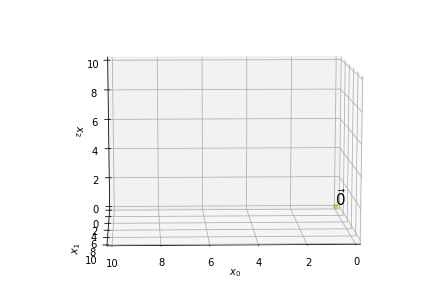

In [175]:
fig,ax=ejes3d(0,0,0,10,10,10)  # Define el eje de coordenadas
animacion3d(fig,ax)  

Es de anotar que no tiene sentido hablar de coordenadas en el subespacio $\{\vec{0}\}$.

Este es <u>espacio columna</u> de la matriz cero. Sin embargo, es el <u>espacio nulo</u> de las matrices LI. 

# Ejercicio:

In [ ]:
nombre = ' Escriba su nombre aquí    '
codigo = 0

Para cada uno de los siguientes subespacios:
1. $\text{Co}\left(\left[\matrix{
a+1 & a+b+2 & a+2b+3 & a+3b+4 & \\
a+3b+4 & a+1 & a+b+2 & a+2b+3 & \\
a+2b+3 & a+3b+4 & a+1 & a+b+2 & \\
}\right]\right)$
1. $\text{Co}\left(\left[\matrix{
a+1    & 3a+3     & a+2b+3 & 2a+2b+4 & \\
a+3b+4 & 3a+9b+12 & a+b+2  & 2a+4b+6 & \\
a+2b+3 & 3a+6b+9  & a+1    & 2a+2b+4 & \\
}\right]\right)$
1. $\text{Co}\left(\left[\matrix{
a+1    & 3a+3     & 2a+2    & 5a+5      \\
a+3b+4 & 3a+9b+12 & 2a+6b+8 & 5a+15b+20 \\
a+2b+3 & 3a+6b+9  & 2a+4b+6 & 5a+10b+15 \\
}\right]\right)$
1. $\text{Nu}\left(\left[\matrix{
a+1 & a+b+2 & a+2b+3  \\
a+3b+4 & a+1 & a+b+2  \\
a+2b+3 & a+3b+4 & a+1  \\
}\right]\right)$

Encuentre:
* Una base.
* Su dimensión.
* Una descripción geométrica 
* La gráfica
* Las coordenadas del vector $\left(\matrix{4a+4\\ 4a+12b+16 \\4a+8b+12}\right)$

Agregue las celdas necesarias para realizar el procedimiento correspondiente. No altere los nombres de las variables de las respuestas ya que serán necesarias para la calificación automática.

In [176]:
base_ejercicio_1 = sp.Matrix() 
base_ejercicio_1

Matrix(0, 0, [])

In [177]:
dimension_ejercicio_1 = 0 
dimension_ejercicio_1

0

In [178]:
geometricamente_ejercicio_1 = ' escribir aquí '

In [179]:
# gráfica del ejercicio 1

In [180]:
coordenadas_ejercicio_1 = sp.Matrix() 
coordenadas_ejercicio_1

Matrix(0, 0, [])

In [181]:
base_ejercicio_2 = sp.Matrix() 
base_ejercicio_2

Matrix(0, 0, [])

In [182]:
dimension_ejercicio_2 = 0 
dimension_ejercicio_2

0

In [183]:
geometricamente_ejercicio_2 = ' escribir aquí '

In [184]:
# gráfica del ejercicio 2

In [185]:
coordenadas_ejercicio_2 = sp.Matrix() 
coordenadas_ejercicio_2

Matrix(0, 0, [])

In [186]:
coordenadas_ejercicio_2 = sp.Matrix() 
coordenadas_ejercicio_2

Matrix(0, 0, [])

In [187]:
base_ejercicio_3 = sp.Matrix() 
base_ejercicio_3

Matrix(0, 0, [])

In [188]:
dimension_ejercicio_3 = 0 
dimension_ejercicio_3

0

In [189]:
geometricamente_ejercicio_3 = ' escribir aquí '

In [190]:
# gráfica del ejercicio 3

In [191]:
coordenadas_ejercicio_3 = sp.Matrix() 
coordenadas_ejercicio_3

Matrix(0, 0, [])

In [192]:
base_ejercicio_4 = sp.Matrix() 
base_ejercicio_4

Matrix(0, 0, [])

In [193]:
dimension_ejercicio_4 = 0 
dimension_ejercicio_4

0

In [194]:
geometricamente_ejercicio_4 = ' escribir aquí '

In [195]:
# gráfica del ejrcicio 4

In [196]:
coordenadas_ejercicio_4 = sp.Matrix() 
coordenadas_ejercicio_4

Matrix(0, 0, [])